In [1]:
import os, re
import numpy as np
import pandas as pd
from IPython.display import display
import warnings
warnings.filterwarnings("ignore") 

import scipy.sparse as sparse
from scipy.io import mmread
from scipy.stats import pearsonr, pointbiserialr

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.lines import Line2D

import seaborn as sns
import scanpy as sc
sc.logging.print_header()
sc.set_figure_params(facecolor="white", figsize=(8, 8))
sc.settings.verbosity = 1 # errors (0), warnings (1), info (2), hints (3)
plt.rcParams["font.family"] = "Arial"
sns.set_style("white")

import random
# Note that BANKSY itself is deterministic, here the seeds affect the umap clusters and leiden partition
seed = 1234
np.random.seed(seed)
random.seed(seed)

## Load Slide-seq Dataset
Allocate path to folder and the file name of the designated AnnaData Object (in `.h5ad` format) <br>

In [2]:
# Define File paths
file_path = os.path.join("data", "slide_seq", "v2")
gcm_filename = "Cerebellum_MappedDGEForR.csv"

# (Optional) Arguments for load_data only if annadata is not present
locations_filename = "Cerebellum_BeadLocationsForR.csv"
adata_filename = "slideseqv2_cerebellum_adataraw.h5ad"


### Loading anndata file or converting raw files to anndata format  (h5ad)

If the specified anndata file is present in the directory, the annadata file `.h5ad` in the file path can be read directly by setting the `load_adata_directly` to `True` <br>
Otherwise, `load_data` can convert the raw data of GCM and locations in `.csv` format to `.h5ad` directly if Annadata file is not present

In [3]:
from banksy_utils.load_data import load_adata, display_adata

# To either load data from .h5ad directly or convert raw data to .h5ad format
load_adata_directly = True # False the first, time, and you need to download the locations and GCM files 
# specified in data/slide_seq/v2/data_sources_readme.txt. After using those files, the adata will be created 
# and saved as a h5ad file. You can then set this to True and use that directly. 

# Keys to specify coordinate indexes in the anndata Object
coord_keys = ('xcoord', 'ycoord', 'coord_xy')

raw_y, raw_x, adata = load_adata(file_path,
                                     load_adata_directly, 
                                     adata_filename, 
                                     gcm_filename, 
                                     locations_filename,
                                     coord_keys)

Looking for data/slide_seq/v2/slideseqv2_cerebellum_adataraw.h5ad
Attemping to read Annadata directly
Anndata file successfully loaded!
Attempting to concatenate spatial x-y under adata.obsm[coord_xy]
Concatenation success!


### Display Anndata Object
Use `display_adata` to show summary of anndata object

In [ ]:
display_adata(adata)

### Preprocess AnnData Object 
We then preprocess the raw adata file with `preprocess_data`, which calculates the QC metrics using `scanpy`'s built-in function `sc.pp.calculate_qc_metrics` and adding them in-place in the anndata object

In [4]:
adata.var_names_make_unique()
adata.var["mt"] = adata.var_names.str.startswith("MT-")

# Calulates QC metrics and put them in place to the adata object
sc.pp.calculate_qc_metrics(adata, 
                           qc_vars=["mt"], 
                           log1p=True, 
                           inplace=True)

### Display the preprocessed adata with added qc_metrics

Now the anndata contains qc_metric under its variables (`adata.var`)

In [5]:
display(adata.obs, adata.var)

,xcoord,ycoord,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt
barcodes,,,,,,,,,,,,,
CTTCCATGACATTT,2892.276596,3060.489362,188,5.241747,245,5.505332,43.673469,64.081633,100.000000,100.000000,0,0.0,0.0
TAGCCGGGTCTCTG,5459.803030,4279.257576,143,4.969813,160,5.081404,41.875000,73.125000,100.000000,100.000000,0,0.0,0.0
GCCTTGCTGAGCTC,1632.575000,3463.375000,539,6.291569,702,6.555357,26.353276,37.464387,51.709402,94.444444,0,0.0,0.0
AGATACCAAGCCTT,3718.147059,3273.235294,364,5.899897,441,6.091310,28.798186,40.136054,62.811791,100.000000,0,0.0,0.0
TGAAACGTGTCATT,3733.886364,5466.000000,1028,6.936343,1499,7.313220,22.615077,30.887258,44.229486,64.776518,0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
GACTCGAGCAAAAA,4214.606061,2584.696970,53,3.988984,59,4.094345,94.915254,100.000000,100.000000,100.000000,0,0.0,0.0
TCTACAAGCAAAAC,4079.536082,4734.577320,43,3.784190,46,3.850148,100.000000,100.000000,100.000000,100.000000,0,0.0,0.0
AAAAATAAAAAAAA,1279.972973,376.756757,21,3.091042,22,3.135494,100.000000,100.000000,100.000000,100.000000,0,0.0,0.0


,mt,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts
Row,,,,,,,
0610005C13Rik,False,1,0.000025,0.000025,99.997468,1,0.693147
0610007P14Rik,False,679,0.018888,0.018712,98.280839,746,6.616065
0610009B22Rik,False,433,0.011672,0.011604,98.903686,461,6.135565
0610009E02Rik,False,33,0.000836,0.000835,99.916447,33,3.526361
0610009L18Rik,False,173,0.004608,0.004597,99.561981,182,5.209486
...,...,...,...,...,...,...,...
mt-Tv,False,160,0.004051,0.004043,99.594896,160,5.081404
n-R5-8s1,False,23,0.000582,0.000582,99.941766,23,3.178054
n-R5s173,False,1,0.000025,0.000025,99.997468,1,0.693147


## Visualize the histogram plot of `total_counts` and `n_genes`
We can visualize the unfiltered and filtered histograms for `total_counts` and `n_genes` variables in the adata object <br> 

The filtered histograms are plotted after filtering by the upper threshold of total counts `total_counts_cuttoff`, the upper threshold of n_genes `n_genes_high_cutoff`, and the lower threshold of n_genes

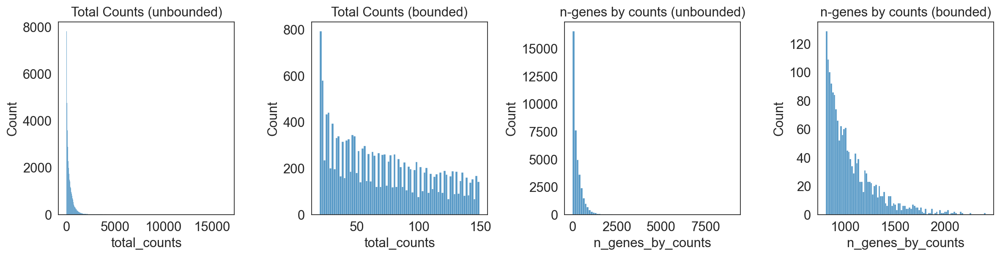

In [6]:
from banksy_utils.plot_utils import plot_qc_hist, plot_cell_positions

# bin options for fomratting histograms
# Here, we set 'auto' for 1st figure, 80 bins for 2nd figure. and so on
hist_bin_options = ['auto', 80, 80, 100]

plot_qc_hist(adata, 
         total_counts_cutoff=150, 
         n_genes_high_cutoff=2500, 
         n_genes_low_cutoff=800,
         bin_options = hist_bin_options)

## Do an initial filter of cells by their cell counts, MT count and gene counts
We can then first filter cells by their counts, MT and gene filters.

In [7]:
from banksy_utils.filter_utils import filter_cells

# Filter cells with each respective filters
adata = filter_cells(adata, 
             min_count=50, 
             max_count=2500, 
             MT_filter=20, 
             gene_filter=10)

Cells before filtering: 39496

Cells after count filter: 33300

cells after MT filter: 33300

Genes after minimum cells per gene filter: 16039



Show summary of adata after filtering by cell counts

In [8]:
display_adata(adata)

Displaying adata Object and their attributes
Adata attributes and dimensions:


AnnData object with n_obs × n_vars = 33300 × 16039
    obs: 'xcoord', 'ycoord', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    obsm: 'coord_xy'

Matrix sparsity: 9657238 filled elements (0.02) out of 534098700
max: 455, min: 1

Displaying observations (adata.obs)


,xcoord,ycoord,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,n_counts
barcodes,,,,,,,,,,,,,,
CTTCCATGACATTT,2892.276596,3060.489362,188,5.241747,245,5.505332,43.673469,64.081633,100.000000,100.000000,0,0.0,0.0,245
TAGCCGGGTCTCTG,5459.803030,4279.257576,143,4.969813,160,5.081404,41.875000,73.125000,100.000000,100.000000,0,0.0,0.0,160
GCCTTGCTGAGCTC,1632.575000,3463.375000,539,6.291569,702,6.555357,26.353276,37.464387,51.709402,94.444444,0,0.0,0.0,702
AGATACCAAGCCTT,3718.147059,3273.235294,364,5.899897,441,6.091310,28.798186,40.136054,62.811791,100.000000,0,0.0,0.0,441
TGAAACGTGTCATT,3733.886364,5466.000000,1028,6.936343,1499,7.313220,22.615077,30.887258,44.229486,64.776518,0,0.0,0.0,1499
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTTTCAAGAAACA,4340.000000,3312.261364,101,4.624973,106,4.672829,51.886792,99.056604,100.000000,100.000000,0,0.0,0.0,106
AGGGTAACGAAAAC,5016.590909,2432.984848,130,4.875197,141,4.955827,43.262411,78.723404,100.000000,100.000000,0,0.0,0.0,141
TTGCCCGTCAAACA,4602.906977,3682.116279,147,4.997212,197,5.288267,50.761421,76.142132,100.000000,100.000000,0,0.0,0.0,197


Displaying variables (adata.var)


,mt,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts,n_cells
Row,,,,,,,,
0610007P14Rik,False,679,0.018888,0.018712,98.280839,746,6.616065,653
0610009B22Rik,False,433,0.011672,0.011604,98.903686,461,6.135565,419
0610009E02Rik,False,33,0.000836,0.000835,99.916447,33,3.526361,31
0610009L18Rik,False,173,0.004608,0.004597,99.561981,182,5.209486,165
0610009O20Rik,False,343,0.009064,0.009023,99.131558,358,5.883322,333
...,...,...,...,...,...,...,...,...
mt-Tq,False,127,0.003241,0.003236,99.678448,128,4.859812,124
mt-Ts2,False,70,0.001772,0.001771,99.822767,70,4.262680,65
mt-Tt,False,15,0.000380,0.000380,99.962021,15,2.772589,14


### Plot the Histograms of the filtered dataset

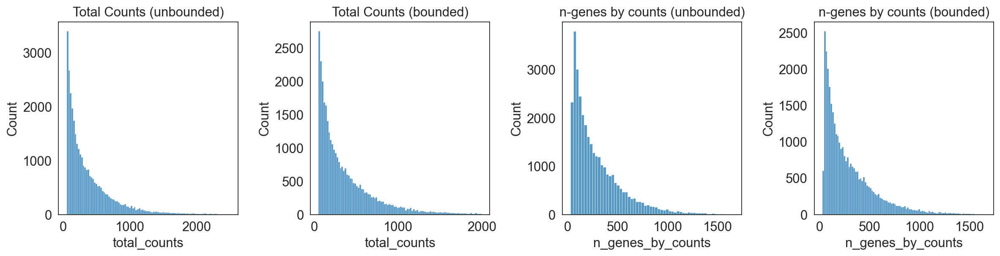

In [9]:
hist_bin_options = ['auto', 100, 60, 100]

plot_qc_hist(adata,
        total_counts_cutoff=2000,
        n_genes_high_cutoff=2000, 
        n_genes_low_cutoff= 0,
        bin_options = hist_bin_options)

### Visualize the position of cells using a scatter plot
For slideseq_v2, we customize the plot with a puck_center 

{'fig_size': (6, 6), 's': 0.2, 'c1': 'red', 'c2': 'slateblue', 'label1': 'Original cells', 'label2': 'Remaining cells', 'add_circle': True, 'puck_center': (3330, 3180), 'puck_radius': 2550}


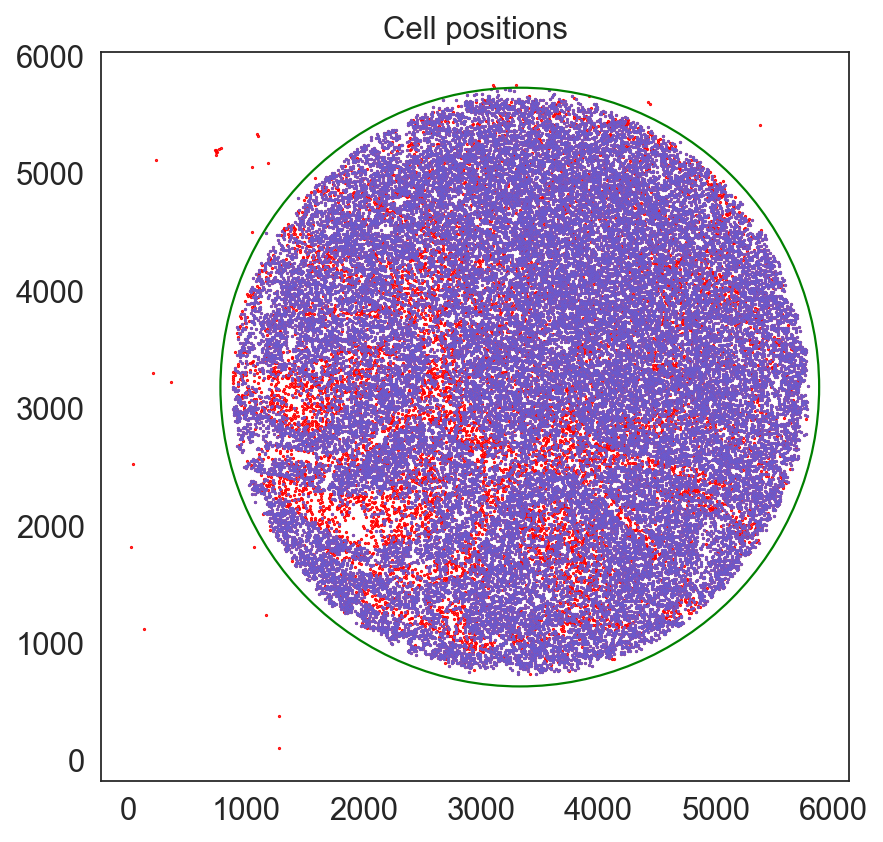

In [10]:
# Filter out beads outside the puck
puck_center = (3330,3180) # (x,y)
puck_radius = 2550
puck_mask = np.sqrt((adata.obs["ycoord"] - puck_center[1])**2 + (adata.obs["xcoord"] - puck_center[0])**2) < puck_radius
adata = adata[puck_mask,:]

# Visualize cell positions in puck
plot_cell_positions(adata,
            raw_x,
            raw_y,
            coord_keys=coord_keys,
            fig_size = (6,6),
            add_circle=True,
            puck_center=puck_center,
            puck_radius=puck_radius)

## Normalize & Filter highly variable genes (HVG)

### Normalize data matrix using `normalize_total`


In [11]:
from banksy_utils.filter_utils import normalize_total, filter_hvg, print_max_min

import anndata
# Normalizes the anndata dataset
adata = normalize_total(adata)

--- Max-Min before normalization -----
Displaying max and min of Dataset
Max: 455, Min: 0

--- Max-Min after normalization -----
Displaying max and min of Dataset
Max: 144.72093200683594, Min: 0.0



### Filter by Highly Variable Genes (HVG) using a specified threshold

We use the **raw count data** (flavor = `"seurat_v3"`) or **log-transformed data** (flavor = `"seurat"`). Here, we recommend using the default `seurat` flavor from `Scanpy`.

Here we keep the original AnnData object (`adata_allgenes`) for the analysis of the results produced by BANKSY if nessecary. However, we will mostly be running banksy with the filtered AnnData object (`adata`)

In [12]:
adata, adata_allgenes = filter_hvg(
    adata,
    n_top_genes=2000,
    flavor="seurat"
)

--- Normalized and log-transformed data -----
Displaying max and min of Dataset
Max: 4.981693267822266, Min: 0.0

Displaying dataset after filtering by HVG
View of AnnData object with n_obs × n_vars = 33278 × 2000
    obs: 'xcoord', 'ycoord', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    obsm: 'coord_xy'


### Check genes and cells annotations

Display attribute of the filtered data after filtering steps and HVG analysis

In [13]:
display_adata(adata)

Displaying adata Object and their attributes
Adata attributes and dimensions:


View of AnnData object with n_obs × n_vars = 33278 × 2000
    obs: 'xcoord', 'ycoord', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    obsm: 'coord_xy'

Matrix sparsity: 1133730 filled elements (0.02) out of 66556000
max: 144.72093200683594, min: 0.1017628163099289

Displaying observations (adata.obs)


,xcoord,ycoord,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,n_counts
barcodes,,,,,,,,,,,,,,
CTTCCATGACATTT,2892.276596,3060.489362,188,5.241747,245,5.505332,43.673469,64.081633,100.000000,100.000000,0,0.0,0.0,245
TAGCCGGGTCTCTG,5459.803030,4279.257576,143,4.969813,160,5.081404,41.875000,73.125000,100.000000,100.000000,0,0.0,0.0,160
GCCTTGCTGAGCTC,1632.575000,3463.375000,539,6.291569,702,6.555357,26.353276,37.464387,51.709402,94.444444,0,0.0,0.0,702
AGATACCAAGCCTT,3718.147059,3273.235294,364,5.899897,441,6.091310,28.798186,40.136054,62.811791,100.000000,0,0.0,0.0,441
TGAAACGTGTCATT,3733.886364,5466.000000,1028,6.936343,1499,7.313220,22.615077,30.887258,44.229486,64.776518,0,0.0,0.0,1499
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTTTCAAGAAACA,4340.000000,3312.261364,101,4.624973,106,4.672829,51.886792,99.056604,100.000000,100.000000,0,0.0,0.0,106
AGGGTAACGAAAAC,5016.590909,2432.984848,130,4.875197,141,4.955827,43.262411,78.723404,100.000000,100.000000,0,0.0,0.0,141
TTGCCCGTCAAACA,4602.906977,3682.116279,147,4.997212,197,5.288267,50.761421,76.142132,100.000000,100.000000,0,0.0,0.0,197


Displaying variables (adata.var)


,mt,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts,n_cells
Row,,,,,,,,
0610043K17Rik,False,219,0.006102,0.006083,99.445513,241,5.488938,212
1110015O18Rik,False,17,0.000430,0.000430,99.956958,17,2.890372,15
1110018N20Rik,False,24,0.000608,0.000607,99.939234,24,3.218876,23
1110019D14Rik,False,197,0.005671,0.005655,99.501215,224,5.416100,192
1110025M09Rik,False,26,0.000760,0.000759,99.934171,30,3.433987,26
...,...,...,...,...,...,...,...,...
mt-Tm,False,335,0.008558,0.008521,99.151813,338,5.826000,318
mt-Tp,False,919,0.023926,0.023645,97.673182,945,6.852243,855
mt-Tq,False,127,0.003241,0.003236,99.678448,128,4.859812,124


## Generate spatial weights graph

#### In BANKSY, we imagine edges / connections in the graph to represent neighbour relationships between cells

In doing so, the banksy algorithm requires the following specifications in the main BANKSY algorithm:

1. The number of spatial neighbours `k_geom`. A good default that seems to work for most datasets is 15 (6 or 18 for Visium, due to its specific geometry). 
    
2. Assigning weights (dependent on inter-cell spatial distances) to edges in the connected spatial graph. By default, we use the `gaussian decay` option, where weights decay as a function of distnace to the index cell with $\sigma$ = `sigma`. As default, we set $\sigma$ to be the median distance between cells, and do not prescribe any cutoff-radius `p_outside` (no cutoff is conducted).

3. The Azumithal Gabor Filter parameter `max_m` which indicates whether to use the AGF (`max_m = 1`) or just the mean expression (`max_m = 0`). By default, we set `max_m = 1`.
    
    
### Construction of the spatial $k_{geom}$ Nearest-Neighbour graph

We represent connections between cells and its neighbours in a graph $G = \{N,E,W\}$, comprising of a set of nodes $n \in N$. edges representing connectivity between cells $e \in E$, the edges are be weighted $w \in W$ as a function of the spatial distance between cells.
    
Weight of edges can be represented by uniform distance (i.e., a closer neighbour will have a higher weight), or using `reciprocal` ($\frac{1}{r})$. As mentioned above, BANKSY by default applies a gaussian envelope function to map the distance (between nodes) to the `weights` the connection of cell-to-neighbor

In [14]:
from banksy.main import median_dist_to_nearest_neighbour

# set params
# ==========
plot_graph_weights = True
k_geom = 15 # number of spatial neighbours
max_m = 1 # use both mean and AFT
nbr_weight_decay = "scaled_gaussian" # can also choose "reciprocal", "uniform" or "ranked"

# Find median distance to closest neighbours
nbrs = median_dist_to_nearest_neighbour(adata, key = coord_keys[2])
# nbrs = NearestNeighbors(algorithm='ball_tree').fit(adata.obsm[coord_keys[2]])

Using igraph version 0.11.9
Using leidenalg version 0.10.2


Median distance to closest cell = 15.162166157785578

---- Ran median_dist_to_nearest_neighbour in 0.07 s ----



### Generate spatial weights from distance

Here, we generate the spatial weights using the gaussian decay function from the median distance to the k-th nearest neighbours as specified earlier.

The utility functions `plot_edge_histograms`, `plot_weights`, `plot_theta_graph` can be used to visualize the characteristics of the edges, weights and theta (from the AGF) respectively.

#### Optional Visualization of Weights and edge graphs

(1) **Visualize the edge histogram** to show the histogram of distances between cells and the weights between cells by setting `plt_edge_hist = True`

(2) **Visualize weights** by plotting the connections. Line thickness is proportional to edge weight (normalized by highest weight across all edges) by setting `plt_weights = True`

(3) **Visualize weights with Azimuthal angles**. Visualizing the azimuthal angles computed by the AGF by colour, the azimuthal connectivities are annotated in red. Warning: this plot many take a few minutes to compute for large datasets. `plt_agf_angles = False`

(4) **Visualize angles around random cell**. Plot points around a random index cell, annotated with angles from the index cell. `plot_theta = True`


Median distance to closest cell = 15.1622

---- Ran generate_spatial_distance_graph in 0.16 s ----

---- Ran row_normalize in 0.06 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 0.73 s ----

----- Plotting Edge Histograms for m = 0 -----

Edge weights (distances between cells): median = 35.163551502701175, mode = 40.787426924992936

---- Ran plot_edge_histogram in 0.04 s ----


Edge weights (weights between cells): median = 0.058971382268315664, mode = 0.028720281769638176

---- Ran plot_edge_histogram in 0.07 s ----

---- Ran generate_spatial_distance_graph in 0.28 s ----

---- Ran theta_from_spatial_graph in 0.32 s ----

---- Ran row_normalize in 0.06 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 1.06 s ----

----- Plotting Edge Histograms for m = 1 -----

Edge weights (distances between cells): median = 50.306842426665796, mode = 55.2798791435038

---- Ran plot_edge_histogram in 0.05 s ----


Edge weights (weights between cells): median = (1.7346078067161682e-05+

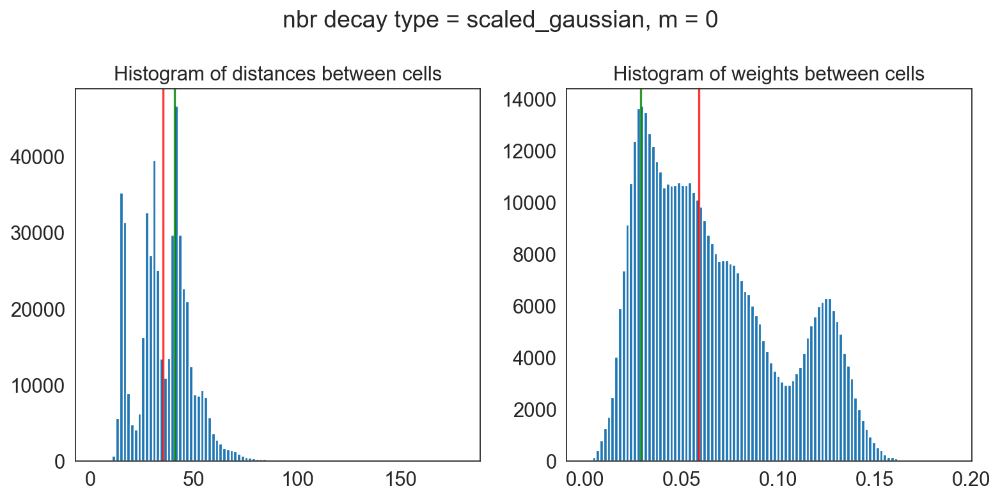

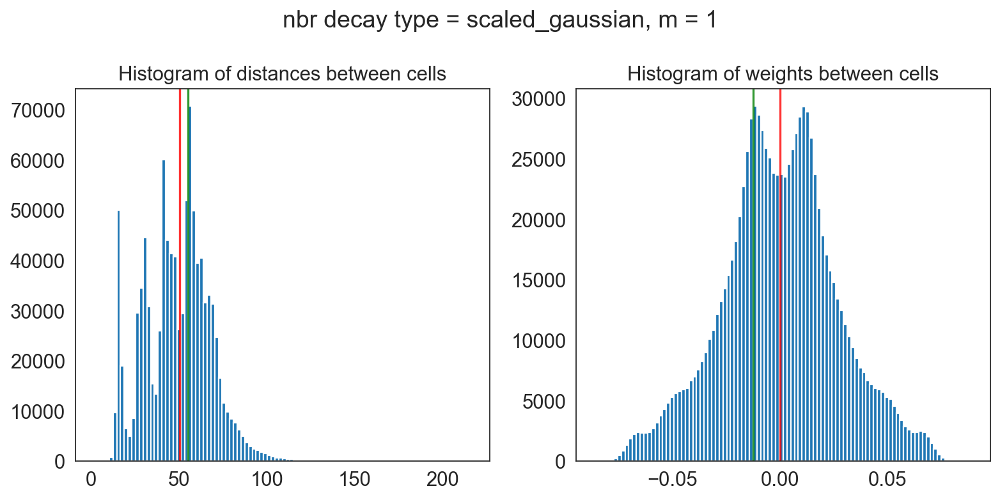

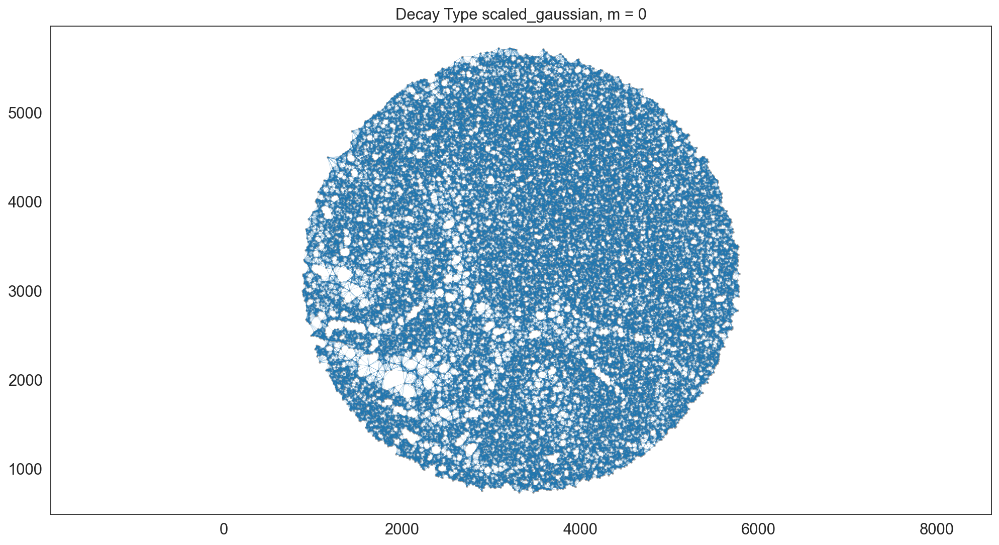

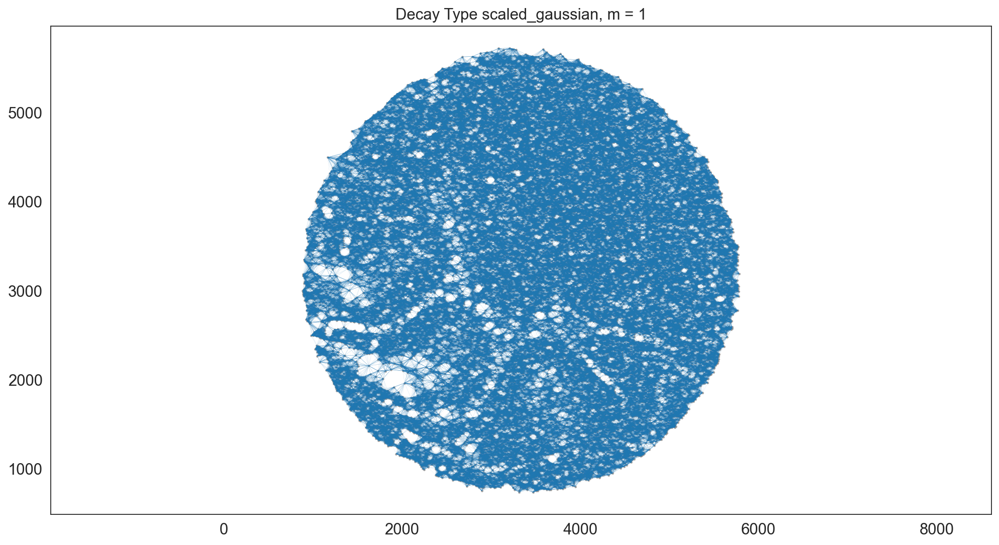

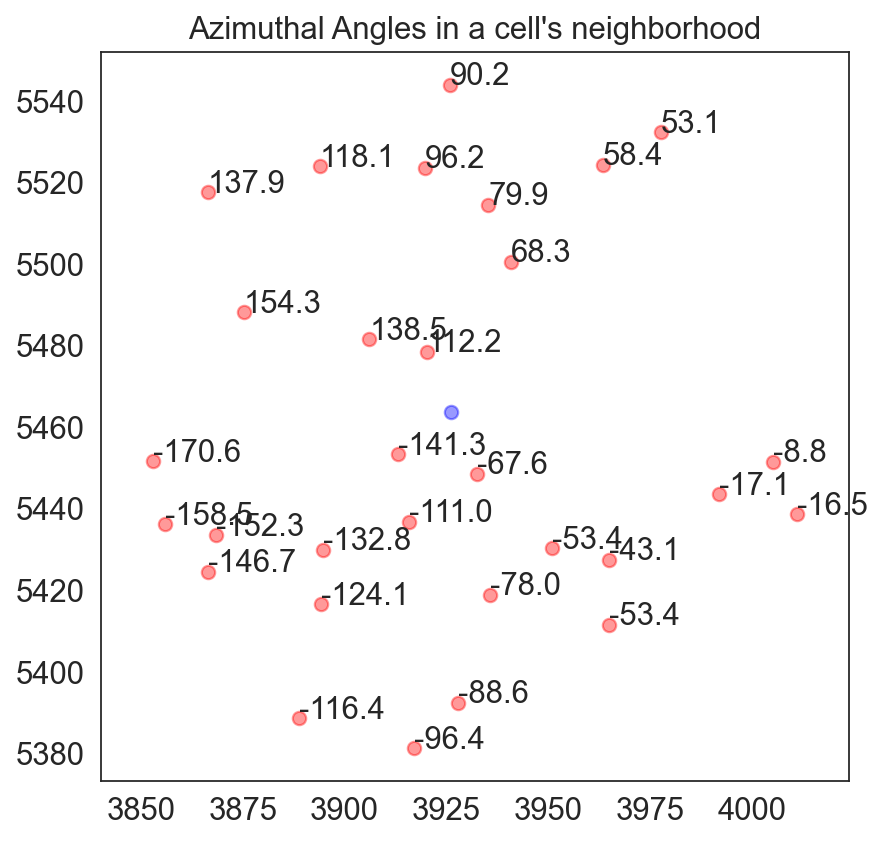

In [15]:
from banksy.initialize_banksy import initialize_banksy

banksy_dict = initialize_banksy(
    adata,
    coord_keys,
    k_geom,
    nbr_weight_decay=nbr_weight_decay,
    max_m=max_m,
    plt_edge_hist=True,
    plt_nbr_weights=True,
    plt_agf_angles=False, # takes long time to plot
    plt_theta=True,
)

## Generate BANKSY matrix

To generate the BANKSY matrix, we proceed with the following:

1. Matrix multiply sparse CSR weights matrix with cell-gene matrix to get **neighbour matrix** and the **AGF matrix** if `max_m` > 1
2. Z-score both matrices along **genes**
3. Multiply each matrix by a weighting factor $\lambda$ (We refer to this parameter as `lambda` in our manuscript and code)
4. Concatenate the matrices along the genes dimension in the form -> `horizontal_concat(cell_mat, nbr_mat, agf_mat)`

Here, we save all the results in the dictionary (`banksy_dict`), which contains the results from the subsequent operations for BANKSY. 

In [16]:
from banksy.embed_banksy import generate_banksy_matrix

# The following are the main hyperparameters for BANKSY
# -----------------------------------------------------
resolutions = [0.7]  # clustering resolution for UMAP
pca_dims = [20]  # Dimensionality in which PCA reduces to
lambda_list = [0.2]  # list of lambda parameters

banksy_dict, banksy_matrix = generate_banksy_matrix(adata,
                                                    banksy_dict,
                                                    lambda_list,
                                                    max_m)

Runtime Oct-28-2025-15-07

2000 genes to be analysed:
Gene List:
Index(['0610043K17Rik', '1110015O18Rik', '1110018N20Rik', '1110019D14Rik',
       '1110025M09Rik', '1190005I06Rik', '1200014J11Rik', '1500009C09Rik',
       '1700001G11Rik', '1700001J03Rik',
       ...
       'mt-Rnr1', 'mt-Rnr2', 'mt-Tc', 'mt-Ti', 'mt-Tl1', 'mt-Tm', 'mt-Tp',
       'mt-Tq', 'mt-Ts2', 'mt-Tv'],
      dtype='object', name='Row', length=2000)

Check if X contains only finite (non-NAN) values
Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <Compressed Sparse Row sparse matrix of dtype 'float64'
	with 499170 stored elements and shape (33278, 33278)>, 1: <Compressed Sparse Row sparse matrix of dtype 'complex128'
	with 998340 stored elements and shape (33278, 33278)>}}

Nbr matrix | Mean: 0.03 | Std: 0.38
Size of Nbr | Shape: (33278, 2000)
Top 3 entries of Nbr Mat:

[[0.        0.        0.       ]
 [0.        0.        0.       ]
 [0.0203437 0.        0.       ]]

AGF matrix | Mean: 0.01 | Std: 0.0

### Append Non-spatial results to the `banksy_dict` for comparsion

In [17]:
from banksy.main import concatenate_all

banksy_dict["nonspatial"] = {
    # Here we simply append the nonspatial matrix (adata.X) to obtain the nonspatial clustering results
    0.0: {"adata": concatenate_all([adata.X], 0, adata=adata), }
}

print(banksy_dict['nonspatial'][0.0]['adata'])

Scale factors squared: [1.]
Scale factors: [1.]
AnnData object with n_obs × n_vars = 33278 × 2000
    obs: 'xcoord', 'ycoord', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'is_nbr', 'k'


## Reduce dimensions of each data matrix
We utilize two common methods for dimensionality reduction:

1. PCA (using `scikit-learn`), we reduce the size of the matrix from $3*N_{genes}$ to `pca_dims`. As a default settings, we reduce to 20 dimensions.
2. UMAP (`UMAP` package), which we use to visualize expressions of clusters in the umap space (2-D space).

In [18]:
from banksy_utils.umap_pca import pca_umap

pca_umap(banksy_dict,
         pca_dims = pca_dims,
         add_umap = True,
         plt_remaining_var = False,
         )

Current decay types: ['scaled_gaussian', 'nonspatial']

Reducing dims of dataset in (Index = scaled_gaussian, lambda = 0.2)

Setting the total number of PC = 20
Original shape of matrix: (33278, 6000)
Reduced shape of matrix: (33278, 20)
------------------------------------------------------------
min_value = -107.19128571136355, mean = 7.601214433878108e-17, max = 265.9487316210414

Conducting UMAP and adding embeddings to adata.obsm["reduced_pc_20_umap"]
UMAP embedding
------------------------------------------------------------
shape: (33278, 2)


AxisArrays with keys: reduced_pc_20, reduced_pc_20_umap

Reducing dims of dataset in (Index = nonspatial, lambda = 0.0)

Setting the total number of PC = 20
Original shape of matrix: (33278, 2000)
Reduced shape of matrix: (33278, 20)
------------------------------------------------------------
min_value = -95.78764674898152, mean = -1.4643013648184286e-16, max = 317.91526724016387

Conducting UMAP and adding embeddings to adata.obsm["reduc

### Cluster cells using a partition algorithm

For the purpose of this dataset, we conduct cluster cells using the `leiden` algorithm (use `!pip install leidenalg` if package missing) partition methods. Other clustering algorithms include `louvain` (another resolution based clustering algorithm), or `mclust` (a clustering based on gaussian mixture model). 

Note that by default, we recommend resolution-based clustering (i.e., `leiden` or `louvain`) if no prior information on the number of clusters known. However, if the number of clusters is known *a priori*, the user can use `mclust` (gaussian-mixture model) by specifying the number of clusters beforehand.

In [19]:
from banksy.cluster_methods import run_Leiden_partition

results_df, max_num_labels = run_Leiden_partition(
    banksy_dict,
    resolutions,
    num_nn = 50, # k_expr: number of neighbours in expression (BANKSY embedding or non-spatial) space
    num_iterations = -1, # run to convergenece
    partition_seed = seed,
    match_labels = True,
)

Decay type: scaled_gaussian
Neighbourhood Contribution (Lambda Parameter): 0.2
reduced_pc_20 

reduced_pc_20_umap 

PCA dims to analyse: [20]

Setting up partitioner for (nbr decay = scaled_gaussian), Neighbourhood contribution = 0.2, PCA dimensions = 20)


Nearest-neighbour weighted graph (dtype: float64, shape: (33278, 33278)) has 1663900 nonzero entries.
---- Ran find_nn in 11.40 s ----


Nearest-neighbour connectivity graph (dtype: int16, shape: (33278, 33278)) has 1663900 nonzero entries.

(after computing shared NN)
Allowing nearest neighbours only reduced the number of shared NN from 33856850 to 1655628.


Shared nearest-neighbour (connections only) graph (dtype: int16, shape: (33278, 33278)) has 1529234 nonzero entries.

Shared nearest-neighbour (number of shared neighbours as weights) graph (dtype: int16, shape: (33278, 33278)) has 1529234 nonzero entries.

sNN graph data:
[13 22 15 ... 15  8 12]

---- Ran shared_nn in 1.21 s ----


-- Multiplying sNN connectivity by weights -

,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,relabeled
nonspatial_pc20_nc0.00_r0.70,nonspatial,0.0,20,0.7,17,"Label object:\nNumber of labels: 17, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 17, number of..."
scaled_gaussian_pc20_nc0.20_r0.70,scaled_gaussian,0.2,20,0.7,13,"Label object:\nNumber of labels: 13, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 13, number of..."


## Plot results

### Visualize the clustering results from BANKSY, including the clusters from the Umap embbedings

Saving figure at data/slide_seq/v2/tmp_png/slideseq_mousecerebellum_nonspatial_pc20_nc0.00_r0.70_spatialmap.png
number of labels: 17
---- Ran plot_2d_embeddings in 0.00 s ----

number of labels: 17
---- Ran plot_2d_embeddings in 0.00 s ----

number of labels: 17
---- Ran plot_2d_embeddings in 0.00 s ----

---- Ran row_normalize in 0.00 s ----


matrix multiplying labels x weights x labels-transpose ((17, 33278) x (33278, 33278) x (33278, 17))

Saving figure at data/slide_seq/v2/tmp_png/slideseq_mousecerebellum_scaled_gaussian_pc20_nc0.20_r0.70_spatialmap.png
number of labels: 13
---- Ran plot_2d_embeddings in 0.00 s ----

number of labels: 13
---- Ran plot_2d_embeddings in 0.01 s ----

number of labels: 13
---- Ran plot_2d_embeddings in 0.00 s ----

---- Ran row_normalize in 0.00 s ----


matrix multiplying labels x weights x labels-transpose ((13, 33278) x (33278, 33278) x (33278, 13))



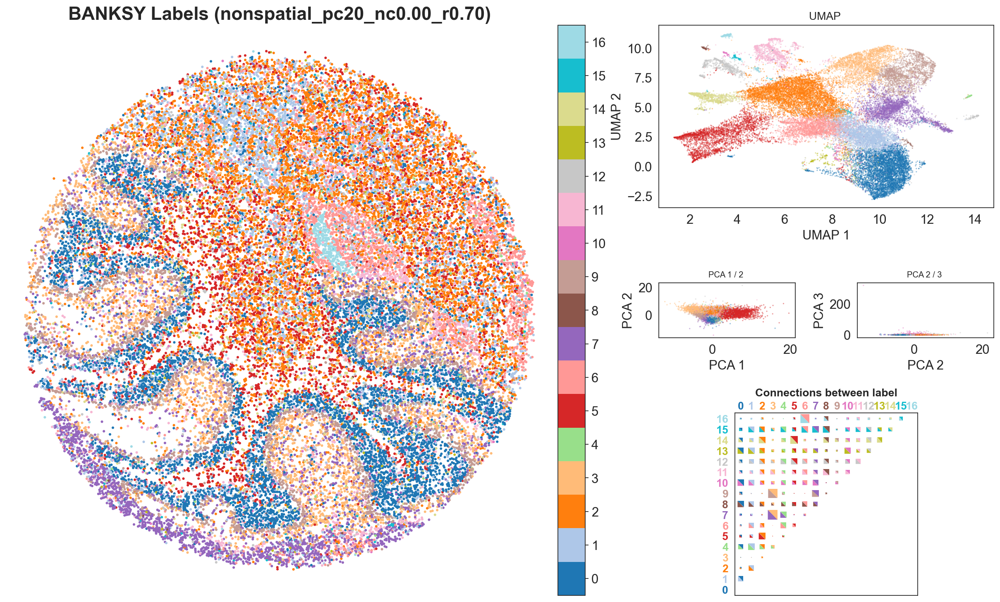

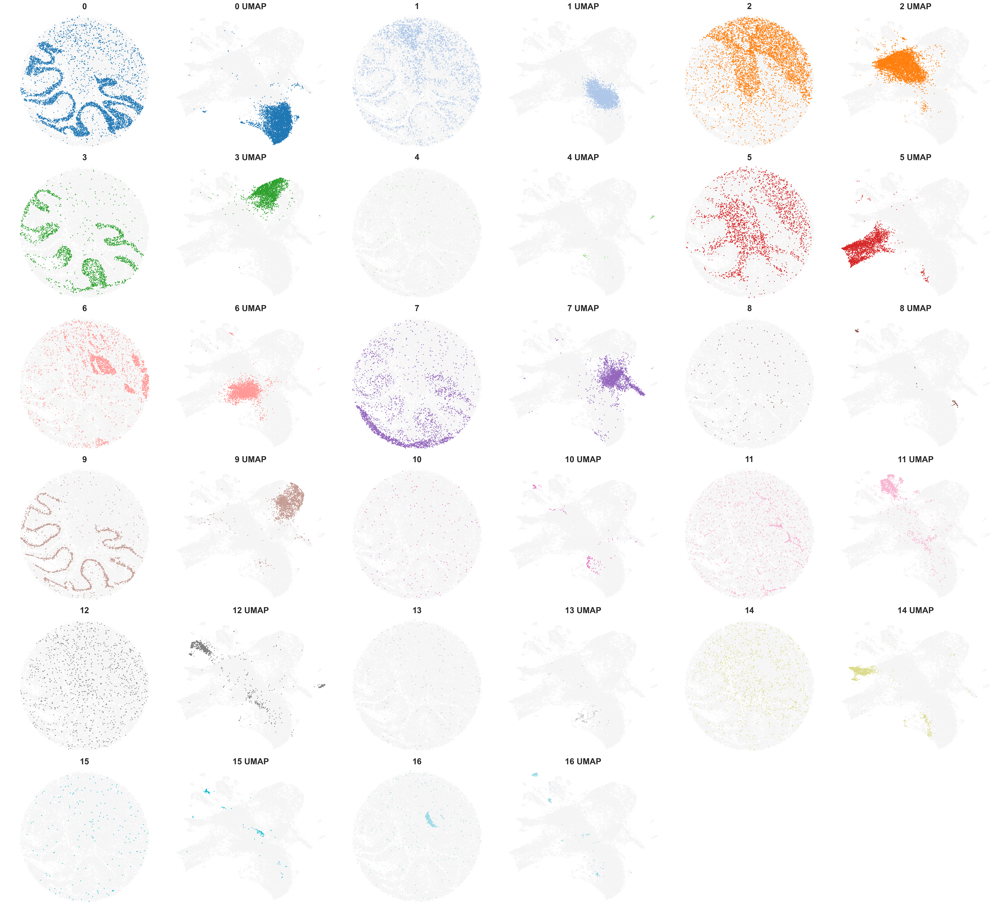

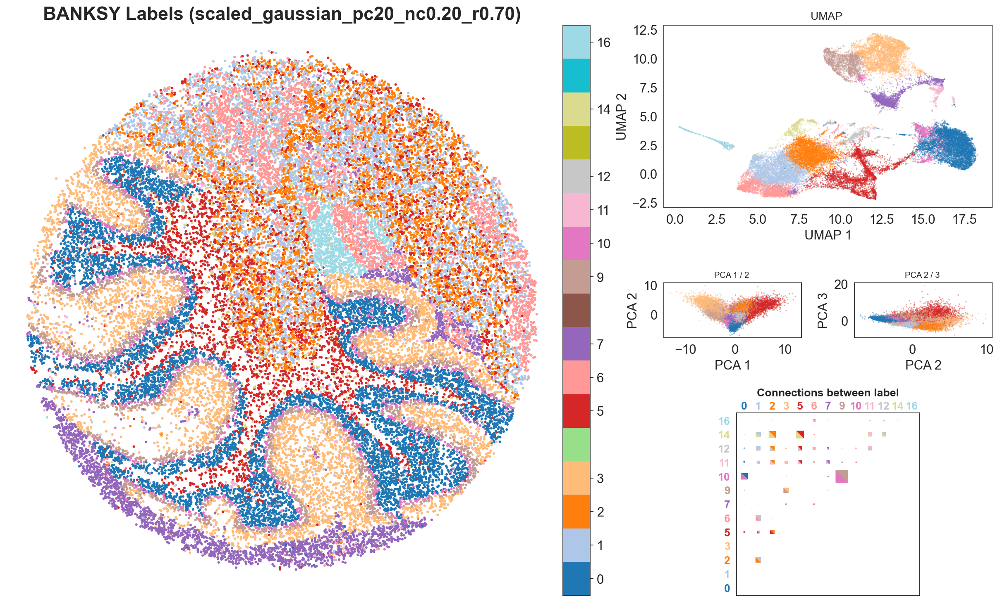

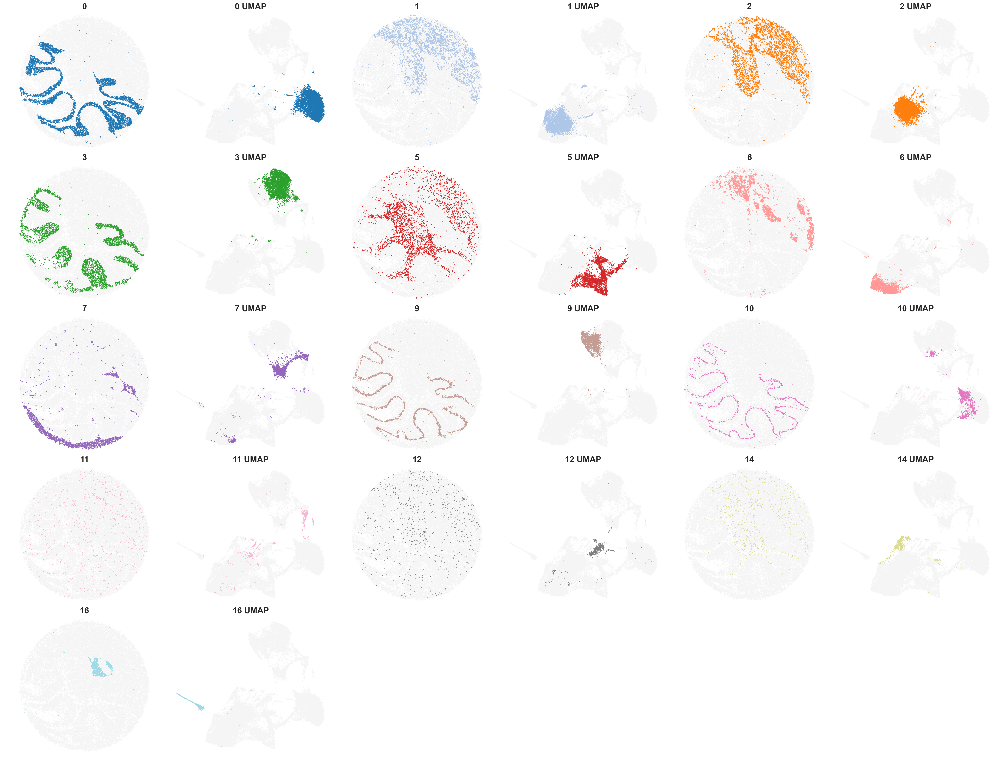

In [20]:
from banksy.plot_banksy import plot_results

c_map =  'tab20' # specify color map
weights_graph =  banksy_dict['scaled_gaussian']['weights'][0]

plot_results(
    results_df,
    weights_graph,
    c_map,
    match_labels = True,
    coord_keys = coord_keys,
    max_num_labels  =  max_num_labels, 
    save_path = os.path.join(file_path, 'tmp_png'),
    save_fig = True
)